# Gradient-based optimization

In [1]:
import drjit as dr
import mitsuba as mi


mi.set_variant('cuda_ad_rgb')


In [2]:
dr.__file__

'/home/yanni/mitsuba3/build/python/drjit/__init__.py'

In [3]:
scene_Adam = mi.load_file('scenes/living_room.xml')
scene_AdamV = mi.load_file('scenes/living_room.xml')
scene_AdamC = mi.load_file('scenes/living_room.xml')
scene_AdamVC = mi.load_file('scenes/living_room.xml')
# key = 'WallsBSDF.brdf_0.reflectance.value'
key = 'PaintingBSDF.brdf_0.reflectance.data'




### Reference image

In [4]:
image_ref = mi.render(scene_Adam)
# print(image_ref.numpy())

# Preview the reference image
mi.util.convert_to_bitmap(image_ref)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veach_ref.exr', image_ref)


Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

In [5]:
image_ref = mi.render(scene_Adam, spp=1, seed=1)
# print(image_ref.numpy())

# Preview the reference image
mi.util.convert_to_bitmap(image_ref)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veach_ref.exr', image_ref)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

In [6]:
params_Adam = mi.traverse(scene_Adam)
params_AdamV = mi.traverse(scene_AdamV)
params_AdamC = mi.traverse(scene_AdamC)

params_AdamVC = mi.traverse(scene_AdamVC)
params_Adam

SceneParameters[
  ------------------------------------------------------------------------------------------------------------------
  Name                                                           Flags    Type  Parent
  ------------------------------------------------------------------------------------------------------------------
  PerspectiveCamera.near_clip                                             float PerspectiveCamera
  PerspectiveCamera.far_clip                                              float PerspectiveCamera
  PerspectiveCamera.shutter_open                                          float PerspectiveCamera
  PerspectiveCamera.shutter_open_time                                     float PerspectiveCamera
  PerspectiveCamera.film.size                                             ScalarVector2u HDRFilm
  PerspectiveCamera.film.crop_size                                        ScalarVector2u HDRFilm
  PerspectiveCamera.film.crop_offset                                      Sc

In [7]:
new_p = mi.Bitmap('scenes/living-room/new_jupyter.png')
bmp = new_p.convert(
    pixel_format=mi.Bitmap.PixelFormat.RGB,
    component_format=mi.Struct.Type.Float32,
    srgb_gamma=True
)

# Thanks to the array interface protocol, it is easy to create a TensorXf from a bitmap object
img = mi.TensorXf(bmp)

mi.util.convert_to_bitmap(img)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [256, 256],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 192 KiB of image data ]
]

### Initial state

In [8]:
# Save the original value
# param_ref_Adam = mi.Color3f(params_Adam[key])
# param_ref_AdamV = mi.Color3f(params_AdamV[key])
# param_ref_AdamVC = mi.Color3f(params_AdamVC[key])

param_ref_Adam = mi.TensorXf(params_Adam[key])
param_ref_AdamV = mi.TensorXf(params_AdamV[key]) 
param_ref_AdamC = mi.TensorXf(params_AdamC[key]) 
param_ref_AdamVC = mi.TensorXf(params_AdamVC[key])

# Set another color value and update the scene
# params_Adam[key] = mi.Color3f(0.01, 0.2, 0.9)
# params_AdamV[key] = mi.Color3f(0.01, 0.2, 0.9)
# params_AdamVC[key] = mi.Color3f(0.01, 0.2, 0.9)

params_Adam[key] = img
params_AdamV[key] = img
params_AdamC[key] = img

params_AdamVC[key] = img


params_Adam.update();
params_AdamV.update();
params_AdamC.update();
params_AdamVC.update();

As expected, when rendering the scene again, the wall has changed color.

In [9]:
image_init = mi.render(scene_Adam)
mi.util.convert_to_bitmap(image_init)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

## Optimization

For gradient-based optimization, Mitsuba ships with standard optimizers including *Stochastic Gradient Descent* ([<code>SGD</code>][1]) with and without momentum, as well as [<code>Adam</code>][2] <cite data-cite="kingma2014adam">[KB14]</cite>. We will instantiate the latter and optimize our scene parameter with a learning rate of `0.05`. 

We then set the color to optimize on the optimizer, which will now hold a copy of this parameter and enable gradient tracking on it. During the optimization process, the optimizer will always perfom gradient steps on those variables. To propagate those changes to the scene, we need to call the `update()` method which will copy the values back into the `params` data structure. As always this method also notifies all objects in the scene whose parameters have changed, in case they need to update their internal state.

This first call to `params.update()` ensures that gradient tracking with respect to our wall color parameter is propagated to the scene internal state. For more detailed explanation on how-to-use the optimizer classes, please refer to the dedicated [how-to-guide][3].

[1]: https://mitsuba.readthedocs.io/en/latest/src/api_reference.html#mitsuba.ad.SGD
[2]: https://mitsuba.readthedocs.io/en/latest/src/api_reference.html#mitsuba.ad.Adam
[3]: https://mitsuba.readthedocs.io/en/latest/src/how_to_guides/use_optimizers.html

In [10]:
opt_Adam = mi.ad.Adam(lr=0.05)
opt_AdamV = mi.ad.AdamV(lr=0.05)
opt_AdamC = mi.ad.AdamC(lr=0.05)
opt_AdamVC = mi.ad.AdamVC(lr=0.05)


opt_Adam[key] = params_Adam[key]
opt_AdamV[key] = params_AdamV[key]
opt_AdamC[key] = params_AdamC[key]
opt_AdamVC[key] = params_AdamVC[key]

params_Adam.update(opt_Adam);
params_AdamV.update(opt_AdamV);
params_AdamC.update(opt_AdamC);

params_AdamVC.update(opt_AdamVC);

At every iteration of the gradient descent, we will compute the derivatives of the scene parameters with respect to the objective function. In this simple experiment, we use the [*mean square error*][1], or $L_2$ error, between the current image and the reference created above.

[1]: https://en.wikipedia.org/wiki/Mean_squared_error

In [11]:
def mse(image):
    return dr.mean(dr.sqr(image - image_ref))

In the following cell we define the hyper parameters controlling our optimization loop, such as the number of iterations:

In [12]:
iteration_count = 140

In [13]:
# IGNORE THIS: When running under pytest, adjust parameters to reduce computation time
import os
if 'PYTEST_CURRENT_TEST' in os.environ:
    iteration_count = 2

It is now time to actually perform the gradient-descent loop that executes 50 differentiable rendering iterations.

In [14]:
def optimize(params, scene,opt,param_ref,iteration_count):
    errors = []
    err_init = dr.sum(dr.sqr(param_ref - params[key]))
    errors.append(err_init)
    
    img_mse = []
    img_mse_init = dr.sum(dr.sqr(image_init - image_ref))
    img_mse.append(img_mse_init)
    for it in range(iteration_count):
        # Perform a (noisy) differentiable rendering of the scene
        image = mi.render(scene, params,spp=1, seed = it)
        # Evaluate the objective function from the current rendered image
        loss = mse(image)

        # Backpropagate through the rendering process
        dr.backward(loss, flags = dr.ADFlag.BackPropVarianceCounter | dr.ADFlag.ClearVertices)

        # g = dr.graphviz_ad()
        # g.view()


        # Optimizer: take a gradient descent step
        opt.step()

        # Post-process the optimized parameters to ensure legal color values.
        opt[key] = dr.clamp(opt[key], 0.0, 1.0)

        # Update the scene state to the new optimized values
        params.update(opt)
        
        # Track the difference between the current color and the true value
        err_ref = dr.sum(dr.sqr(param_ref - params[key]))
        print(f"Iteration {it:02d}: parameter error = {err_ref[0]:6f}", end='\r')
        errors.append(err_ref)
        img_mse_ref = dr.sum(dr.sqr(image - image_ref))
        img_mse.append(img_mse_ref)
    print('\nOptimization complete.')
    return errors,img_mse

In [15]:
errors_Adam, img_mse_Adam = optimize(params_Adam, scene_Adam,opt_Adam,param_ref_Adam,iteration_count);
errors_AdamV, img_mse_AdamV = optimize(params_AdamV, scene_AdamV,opt_AdamV,param_ref_AdamV,iteration_count);
errors_AdamC, img_mse_AdamC = optimize(params_AdamC, scene_AdamC,opt_AdamC,param_ref_AdamC,iteration_count);

errors_AdamVC,img_mse_AdamVC = optimize(params_AdamVC, scene_AdamVC,opt_AdamVC,param_ref_AdamVC,iteration_count);


Iteration 139: parameter error = 25737.357422
Optimization complete.
Iteration 139: parameter error = 25817.457031
Optimization complete.
Iteration 139: parameter error = 18416.496094
Optimization complete.
Iteration 139: parameter error = 19264.121094
Optimization complete.


## Results

We can now render the scene again to check whether the optimization process successfully recovered the color of the red wall.

In [16]:
image_final = mi.render(scene_Adam, spp=128)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veavh_adam.exr', image_final)
mi.util.convert_to_bitmap(image_final)


Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

In [17]:
image_final = mi.render(scene_AdamV, spp=128)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veach_V.exr', image_final)
mi.util.convert_to_bitmap(image_final)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

In [18]:
image_final = mi.render(scene_AdamC, spp=128)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veach_V.exr', image_final)
mi.util.convert_to_bitmap(image_final)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

In [19]:
image_final = mi.render(scene_AdamVC, spp=128)
# mi.util.write_bitmap('/Users/yannizhang/Desktop/veach_vc.exr', image_final)
mi.util.convert_to_bitmap(image_final)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [1280, 720],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 2.64 MiB of image data ]
]

It worked!

Note visualizing the objective value directly sometimes gives limited information, since differences between `image` and `image_ref` can be dominated by Monte Carlo noise that is not related to the parameter being optimized. 

Since we know the “true” target parameter in this scene, we can validate the convergence of the optimization by checking the difference to the true color at each iteration:

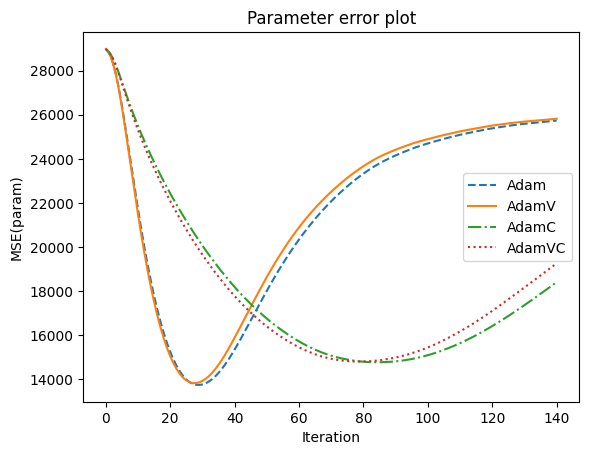

In [20]:
import matplotlib.pyplot as plt

plt.plot(errors_Adam, linestyle='--',label='Adam')
plt.plot(errors_AdamV, linestyle='-',label='AdamV')
plt.plot(errors_AdamC, linestyle='-.',label='AdamC')

plt.plot(errors_AdamVC, linestyle=':',label='AdamVC')
plt.legend()

plt.xlabel('Iteration'); plt.ylabel('MSE(param)'); plt.title('Parameter error plot');
# plt.savefig('/Users/yannizhang/Desktop/veach_mis.png')
plt.show()

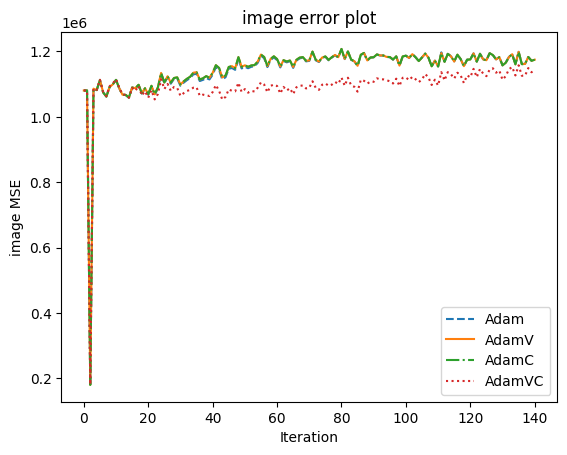

In [22]:
import matplotlib.pyplot as plt

plt.plot(img_mse_Adam, linestyle='--',label='Adam')
plt.plot(img_mse_AdamV, linestyle='-',label='AdamV')
plt.plot(img_mse_AdamV, linestyle='-.',label='AdamC')
plt.plot(img_mse_AdamVC, linestyle=':',label='AdamVC')
plt.legend()

plt.xlabel('Iteration'); plt.ylabel('image MSE'); plt.title('image error plot');
# plt.savefig('/Users/yannizhang/Desktop/RGL/5.10/scene2_adma_V_C.png')
plt.show()

In [23]:
mi.util.write_bitmap('scenes/living-room/jupyter_texture_Adam.exr', params_Adam[key])
mi.util.convert_to_bitmap(params_Adam[key])


Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [256, 256],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 192 KiB of image data ]
]

In [24]:
mi.util.write_bitmap('scenes/living-room/jupyter_texture_AdamV.exr', params_AdamV[key])

mi.util.convert_to_bitmap(params_AdamV[key])


Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [256, 256],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 192 KiB of image data ]
]

In [26]:
mi.util.convert_to_bitmap(params_AdamC[key])

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [256, 256],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 192 KiB of image data ]
]

In [25]:
mi.util.write_bitmap('scenes/living-room/jupyter_texture_AdamVC.exr', params_AdamVC[key])
mi.util.convert_to_bitmap(params_AdamVC[key])


Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [256, 256],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 192 KiB of image data ]
]